# 🔬 [01] MediaPipe: Sign Video to Embedding

- **Experiment No**: 1
- **Author**: Huynh Nhan Thap (21521457@gm.uit.edu.vn)
- **Course**: Computer Science 406: Image Processing and Applications
- **Date**: 2024-11-09

## Description

This experiment aims to demonstrate the process of embedding sign language videos using the MediaPipe Sign Language Recognition (MSLR) model. The provided code snippet demonstrates the initialization of the sign language video object, loading the frames, and embedding them using the MSLR model.

```mermaid
flowchart LR;
    SV(["Sign Video<br/>(F, H, W, C)"]) --> MSLR[(MediaPipe)];
    MSLR --> E(["Embedding<br/>(F, 375)"]);
    E -.-> M[(Model ???)];
    M -.-> T([Text]);
```

(Dotted arrows represent the uminplemented features. F: number of frames. H: frame height. W: frame width. C: number of channels, which is 3.)

I use one sign language video from [QIPEDC dictionary](https://qipedc.moet.gov.vn/dictionary) and a self-recording sign video of myself.

## Results

- The frames of the video were displayed in a grid format.
- The MSLR model embedded the sign language videos.
- The SLT module generated Landmark to visualize the embedding.

## Discussion

- What embedding-to-text models should be used?
- Considering the diversity of Vietnamese sign language dialects (Southern, Northern, Central), should we create a Seq2Seq model for all of them, or just one? If all of them, then how should we apply the dialectal infomation in the overall pipeline?

In [1]:
!ver
!python --version
!conda --version
!conda list


Microsoft Windows [Version 10.0.22631.4460]
Python 3.9.18
conda 24.9.2
# packages in environment at C:\Users\C15TQK\miniconda3\envs\visignlang:
#
# Name                    Version                   Build  Channel
absl-py                   2.1.0                    pypi_0    pypi
aiohappyeyeballs          2.4.3                    pypi_0    pypi
aiohttp                   3.11.2                   pypi_0    pypi
aiosignal                 1.3.1                    pypi_0    pypi
annotated-types           0.7.0              pyhd8ed1ab_0    conda-forge
asttokens                 2.4.1              pyhd8ed1ab_0    conda-forge
async-timeout             5.0.1                    pypi_0    pypi
attrs                     24.2.0             pyh71513ae_0    conda-forge
blas                      1.0                         mkl    conda-forge
brotli-python             1.0.9            py39hd77b12b_8  
ca-certificates           2024.9.24            haa95532_0  
certifi                   2024.8.30        p

## Content

### Using one QIPEDC video

In [2]:
import sign_language_translator as slt

In [3]:
import torch

print('CUDA enabled?:', torch.cuda.is_available())
cuda_device_count = torch.cuda.device_count()
print('CUDA device count:', cuda_device_count)
for i in range(0, cuda_device_count):
    print(f'Device {i}: "{torch.cuda.get_device_name(i)}"')
device = 'cpu' if cuda_device_count == 0 else 'cuda:0'
device

CUDA enabled?: True
CUDA device count: 1
Device 0: "NVIDIA GeForce RTX 3050 Laptop GPU"


'cuda:0'

In [4]:
import os
from IPython.display import Video

video_path = '../assets/D0001B.mp4'
assert os.path.exists(video_path)
Video(video_path)

Sign video shape: (130, 720, 1280, 3)


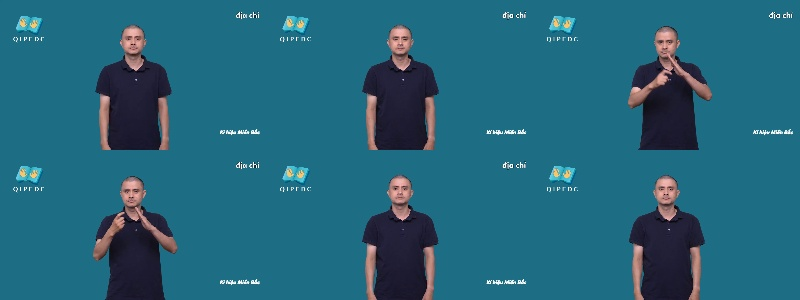

In [5]:
sign = slt.Video(video_path)

print('Sign video shape: %s' % str(sign.shape))
sign.show_frames_grid()

In [6]:
import time

embedding_model = slt.models.MediaPipeLandmarksModel()
start_time = time.time()
embedding = embedding_model.embed(sign.iter_frames())
print('Embedding time: %.2fs' % (time.time() - start_time))
embedding

Embedding time: 16.30s


tensor([[-0.0026, -0.6201, -0.3803,  ...,  0.0000,  0.0000,  0.0000],
        [-0.0045, -0.6199, -0.3682,  ...,  0.0000,  0.0000,  0.0000],
        [-0.0046, -0.6197, -0.3679,  ...,  0.0000,  0.0000,  0.0000],
        ...,
        [-0.0304, -0.6068, -0.2734,  ...,  0.0000,  0.0000,  0.0000],
        [-0.0303, -0.6068, -0.2747,  ...,  0.0000,  0.0000,  0.0000],
        [-0.0302, -0.6069, -0.2748,  ...,  0.0000,  0.0000,  0.0000]])

In [7]:
embedding.shape, embedding.dtype

(torch.Size([130, 375]), torch.float32)

In [8]:
start_time = time.time()
landmarks = slt.Landmarks(embedding.reshape((-1, 75, 5)), 
                          connections='mediapipe-world')
print('Landmark extraction time: %.2fs' % (time.time() - start_time))
landmarks.show()

Landmark extraction time: 0.00s


In [9]:
landmarks_tensor = landmarks.torch().to(device)
landmarks_tensor.shape, landmarks_tensor.dtype, landmarks_tensor.device

(torch.Size([130, 75, 5]), torch.float32, device(type='cuda', index=0))

### Using self-recording sign video

Reached time limit (5.00s)
Sign video shape: (141, 256, 256, 3)


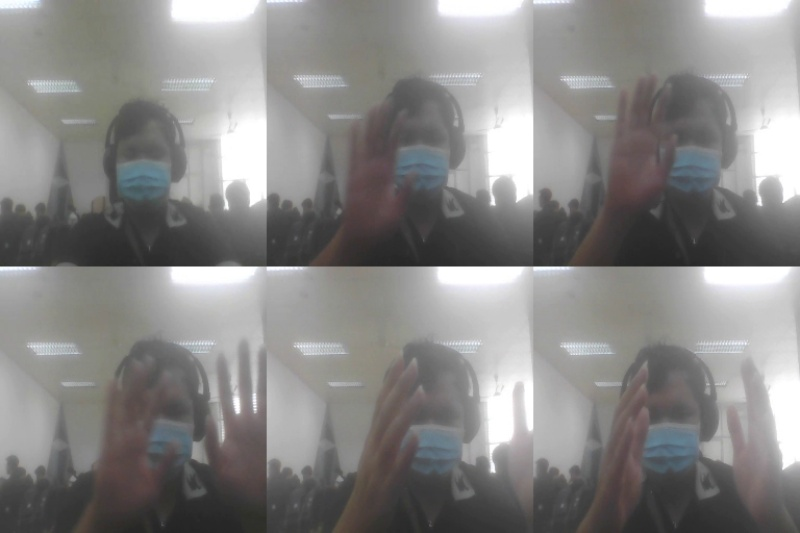

Embedding time: 13.69s
Embedding shape: torch.Size([141, 375])
Landmarks shape: (141, 75, 5)


In [11]:
import cv2

def capture_video(filename: str, *, fps = 10.0, 
                  frame_size: tuple[int, int] = (256, 256), 
                  is_color = True,
                  max_duration_seconds = 5):
    fourcc = cv2.VideoWriter_fourcc(*'MP42')
    out = cv2.VideoWriter(filename, fourcc, fps, frame_size, is_color)
    capture = cv2.VideoCapture(0)
    window_name = 'Video Capture'
    time_limit = time.time() + max_duration_seconds
    while capture.isOpened():
        ret, frame = capture.read()
        if not ret:
            break
        out.write(cv2.resize(frame, frame_size))
        cv2.imshow(window_name, frame)
        cv2.setWindowProperty(window_name, cv2.WND_PROP_TOPMOST, 1)
        if cv2.waitKey(1) & 0xFF == ord('q'):
            break
        if time.time() > time_limit:
            print('Reached time limit (%.2fs)' % max_duration_seconds)
            break
    capture.release()
    out.release()
    cv2.destroyAllWindows()

# "sr" stands for self-recording

sr_video_path = '../assets/exp01_sign.mp4'
capture_video(sr_video_path)

sr_sign = slt.Video(sr_video_path)
print('Sign video shape: %s' % str(sr_sign.shape))
sr_sign.show_frames_grid()

start_time = time.time()
sr_embedding = embedding_model.embed(sr_sign.iter_frames())
print('Embedding time: %.2fs' % (time.time() - start_time))
print('Embedding shape: %s' % str(sr_embedding.shape))

sr_landmarks = slt.Landmarks(sr_embedding.reshape((-1, 75, 5)), 
                          connections='mediapipe-world')
print('Landmarks shape: %s' % str(sr_landmarks.shape))

sr_landmarks.show()

Video(sr_video_path)